In [75]:
import os
import pandas as pd
from pathlib import Path
import numpy as np
import Functional_Fusion.atlas_map as am
from Functional_Fusion.dataset import DataSetMDTB, DataSetPontine
import Functional_Fusion.dataset as ds
from ProbabilisticParcellation.util import plot_multi_flat
import nibabel as nb
import subprocess
import paths as paths
import Functional_Fusion.connectivity as conn
import matplotlib.pyplot as plt
from scripts.var_decomp import reshape_data
import SUITPy as suit
import nitools as nt
import PcmPy as pcm
from nilearn import plotting
import seaborn as sb


In [76]:
base_dir = paths.set_base_dir()
atlas_dir = paths.set_atlas_dir(base_dir)
dname = 'MDTB'
data_dir = base_dir + '/' + dname
atlas_dir = base_dir + '/Atlases'
figure_dir = paths.set_figure_dir()

In [77]:
# -- Get resting-state subjects --
T = pd.read_csv(
    data_dir + '/participants.tsv', delimiter='\t')
subject_subset = T.participant_id[T['ses-rest'] == 1].tolist()


# # -- MDTB Variance decomposition --
mean_centering = True
mdtb_dataset = DataSetMDTB(data_dir)

In [ ]:
# Import data
# # --- Resting-state ---
data_rest, info_rest = mdtb_dataset.get_data(ses_id='ses-rest', type='Net69Run', space='MNISymC2', subj=subject_subset)
data_reshaped_rest = reshape_data(data_rest, info_rest, cond_column='net_id', mean_centering=mean_centering)

# # --- Resting-state : Icosahedron 42 ---
data_rest_ico42, info_rest_ico42 = mdtb_dataset.get_data(ses_id='ses-rest', type='Ico42Run', space='MNISymC2', subj=subject_subset)
data_reshaped_rest_ico42 = reshape_data(data_rest_ico42, info_rest_ico42, cond_column='net_id', mean_centering=mean_centering)

# # --- Resting-state : Icosahedron 162 ---
data_rest_ico162, info_rest_ico162 = mdtb_dataset.get_data(ses_id='ses-rest', type='Ico162Run', space='MNISymC2', subj=subject_subset)
data_reshaped_rest_ico162 = reshape_data(data_rest_ico162, info_rest_ico162, cond_column='net_id', mean_centering=mean_centering)



## Get subject-wise variance

In [ ]:
vars_rest = ds.decompose_pattern_into_group_indiv_noise(data_reshaped_rest, criterion='subject_wise')data_reshaped_rest_ico162
print(f'Rest variance\nGroup: {vars_rest[0][0]:.2f}\nSubject: {vars_rest[0][1]:.2f}\nError: {vars_rest[0][2]:.2f}\n')

vars_rest_ico42 = ds.decompose_pattern_into_group_indiv_noise(data_reshaped_rest_ico42, criterion='subject_wise')
print(f'Rest Ico42 variance\nGroup: {vars_rest[0][0]:.2f}\nSubject: {vars_rest[0][1]:.2f}\nError: {vars_rest[0][2]:.2f}\n')


Rest variance
Group: 0.00
Subject: 0.00
Error: 0.00

Rest Ico42 variance
Group: 0.00
Subject: 0.00
Error: 0.00



In [ ]:
vars_rest

array([[0.0017696 , 0.00244003, 0.0034845 ],
       [0.00502685, 0.01205523, 0.01170615],
       [0.00264556, 0.00717946, 0.00583838],
       [0.00363511, 0.00653796, 0.00988716],
       [0.00163781, 0.00062546, 0.00689271],
       [0.0018674 , 0.00203123, 0.00493176],
       [0.00211662, 0.00458374, 0.00465764],
       [0.00204589, 0.00177843, 0.00746947],
       [0.0033804 , 0.00593467, 0.00534123],
       [0.00194354, 0.00133941, 0.00413965],
       [0.00345483, 0.00675475, 0.00691277],
       [0.00225188, 0.0035592 , 0.00356737],
       [0.00280392, 0.0039858 , 0.00727659],
       [0.00414264, 0.00828277, 0.00486225],
       [0.00204292, 0.00240311, 0.00358748],
       [0.00190893, 0.00857112, 0.00604798],
       [0.00257621, 0.00310739, 0.00367055]])

In [ ]:
np.array(vars_rest) / np.sum(vars_rest, axis=1)[:, np.newaxis]

array([[0.22999326, 0.31712897, 0.45287777],
       [0.17461458, 0.41875557, 0.40662985],
       [0.16890072, 0.45835911, 0.37274017],
       [0.18120966, 0.32591643, 0.4928739 ],
       [0.17887899, 0.06831187, 0.75280914],
       [0.21147403, 0.23002737, 0.55849859],
       [0.18635457, 0.40356958, 0.41007585],
       [0.1811514 , 0.15746965, 0.66137895],
       [0.23064497, 0.40492259, 0.36443245],
       [0.26184123, 0.18044994, 0.55770883],
       [0.20177311, 0.39449897, 0.40372792],
       [0.24011197, 0.37950879, 0.38037924],
       [0.19933589, 0.28335796, 0.51730615],
       [0.23962981, 0.47911469, 0.2812555 ],
       [0.25429969, 0.29913569, 0.44656462],
       [0.1154963 , 0.51858089, 0.3659228 ],
       [0.27540831, 0.33219419, 0.3923975 ]])

## Normalized

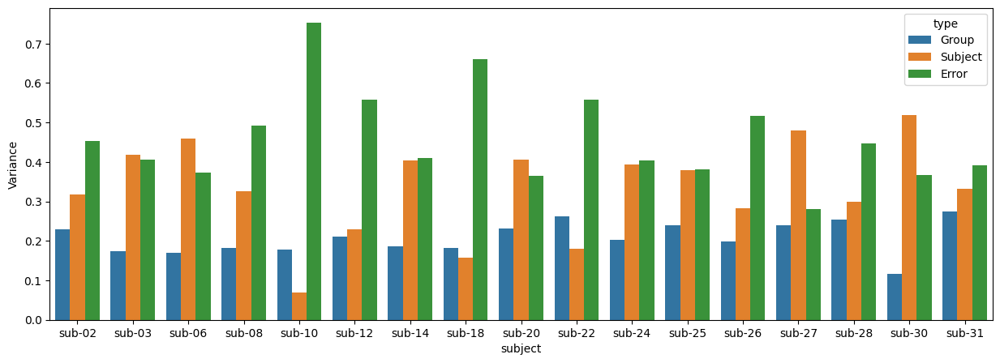

In [ ]:
# Normalize by mean of group+subject+error
vars_rest_norm = np.array(vars_rest) / np.sum(vars_rest, axis=1)[:, np.newaxis]
V_rest = pd.DataFrame(vars_rest_norm, columns=['Group', 'Subject', 'Error'])
V_rest['subject'] = subject_subset
V_rest_melted = V_rest.melt(id_vars=['subject'], value_vars=['Group', 'Subject', 'Error'], var_name='type', value_name='Variance')

# Plot barblot of all subject variances
plt.figure(figsize=(15, 5))
sb.barplot(data=V_rest_melted, x='subject', hue='type', y='Variance')
plt.show()


## Nonnormalized

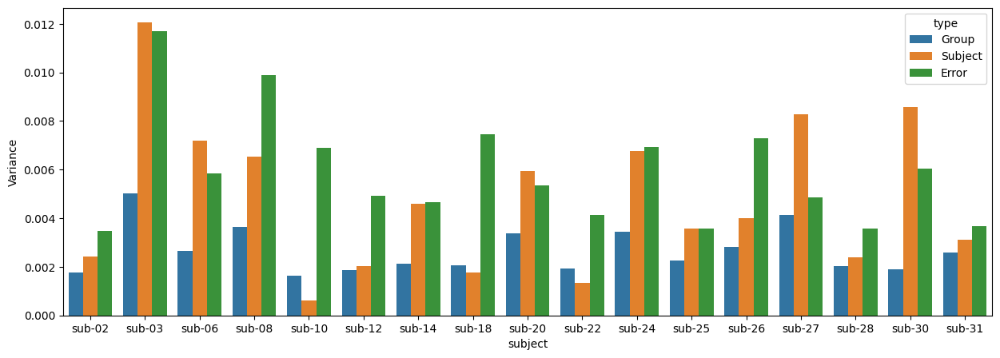

In [ ]:
# Normalize by mean of group+subject+error
V_rest = pd.DataFrame(vars_rest, columns=['Group', 'Subject', 'Error'])
V_rest['subject'] = subject_subset
V_rest_melted = V_rest.melt(id_vars=['subject'], value_vars=['Group', 'Subject', 'Error'], var_name='type', value_name='Variance')

# Plot barblot of all subject variances
plt.figure(figsize=(15, 5))
sb.barplot(data=V_rest_melted, x='subject', hue='type', y='Variance')
plt.show()


## Network exploration

In [ ]:
# Load the cortical networks
net = nb.load(mdtb_dataset.base_dir +
                f'/../targets/Net69_space-fs32k.dscalar.nii')

# Get fs32k surface
atlas_fs, _ = am.get_atlas("fs32k", atlas_dir)

In [ ]:
# Project average to surace map
cifti_img = atlas_fs.data_to_cifti(net.get_fdata())
cortical_map_surf = nt.surf_from_cifti(cifti_img)

network = 0

# Plot the cortical map
view = "lateral"
cmap = "bwr"
colorbar = False
surfs = [atlas_dir + f"/tpl-fs32k/tpl-fs32k_hemi-{hemi}_inflated.surf.gii" for hemi in ['L', 'R']]
ax = []
for h, hemi in enumerate(['left', 'right']):
    fig = plotting.plot_surf_stat_map(
                                    surfs[h], cortical_map_surf[h][network, :], hemi=hemi,
                                    # title='Surface left hemisphere',
                                    colorbar=colorbar, 
                                    view = view,
                                    cmap=cmap,
                                    engine='plotly',
                                    symmetric_cbar = True,
                                )
    ax.append(fig.figure)


    # setting up cameras to get a better view of the hand area in the lateral view
    # rotate to get a better view of M1 only on lateral view
    camera_params = []
    camera_params.append(dict( #left hemi
        center=dict(x=0,y=0,z=0),
        eye=dict(x=-1.5, y=0,z=0.9),
        up=dict(x=0,y=0,z=1),
    ))
    camera_params.append(dict( # right hemi
        center=dict(x=0,y=0,z=0),
        eye=dict(x=1.5, y=0,z=0.9),
        up=dict(x=0,y=0,z=1),
    ))
    hemis = ["L", "R"]
    if view == "lateral":
        ax[h].update_layout(scene_camera=camera_params[h])
    ax[h].show()


/Users/callithrix/code/Python/Functional_Fusion/env/lib/python3.9/site-packages/nilearn/plotting/js_plotting_utils.py:81: UserWarning: vmin cannot be chosen when cmap is symmetric
  warnings.warn('vmin cannot be chosen when cmap is symmetric')


/Users/callithrix/code/Python/Functional_Fusion/env/lib/python3.9/site-packages/nilearn/plotting/js_plotting_utils.py:81: UserWarning:

vmin cannot be chosen when cmap is symmetric



## Plot all networks

/Users/callithrix/code/Python/Functional_Fusion/env/lib/python3.9/site-packages/nilearn/plotting/surf_plotting.py:556: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



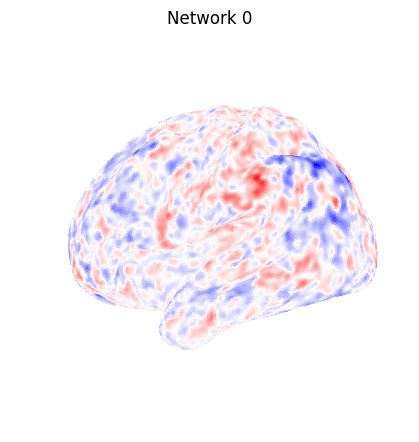

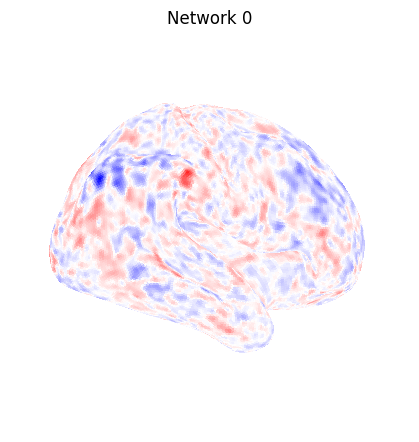

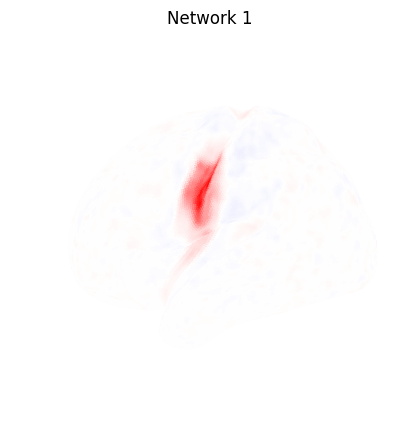

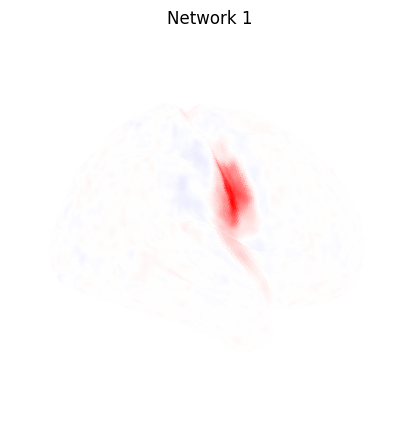

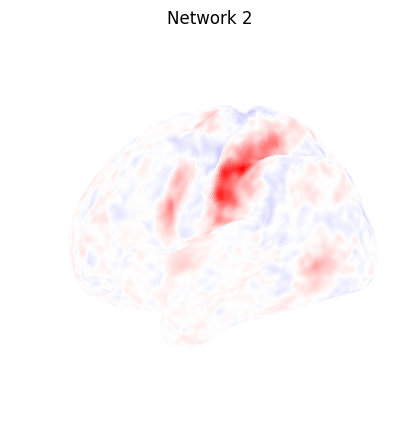

...

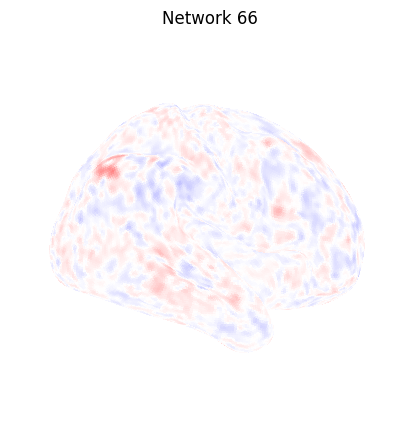

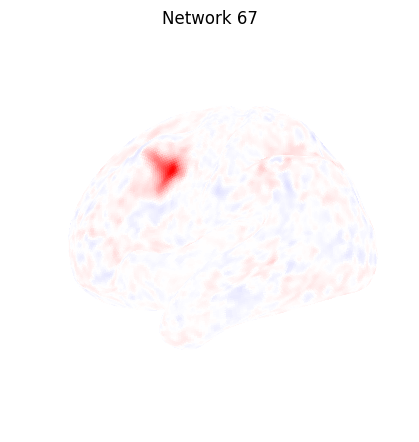

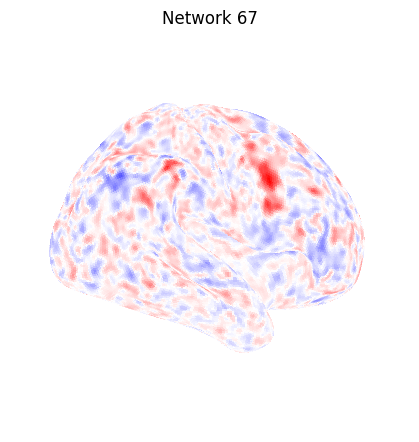

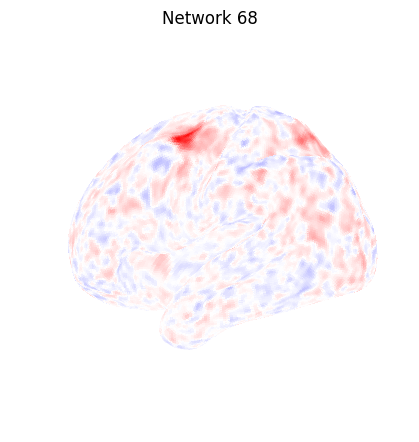

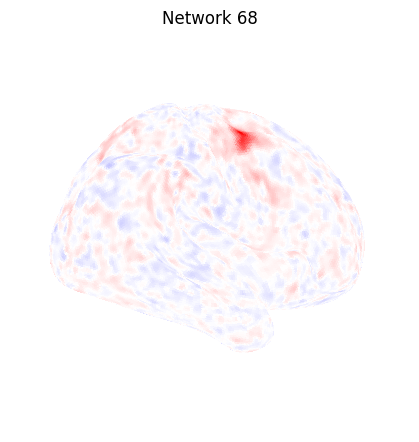

In [82]:
# Plot all cortical networks
view = "lateral"
cmap = "bwr"
colorbar = False
surfs = [atlas_dir + f"/tpl-fs32k/tpl-fs32k_hemi-{hemi}_inflated.surf.gii" for hemi in ['L', 'R']]

for network in range(0, net.shape[0]):
    ax = []
    for h, hemi in enumerate(['left', 'right']):
        fig = plotting.plot_surf_stat_map(
                                        surfs[h], cortical_map_surf[h][network, :], hemi=hemi,
                                        title=f'Network {network}',
                                        colorbar=colorbar, 
                                        view = view,
                                        cmap=cmap,
                                        engine='matplotlib',
                                        symmetric_cbar = True,
                                    )
        ax.append(fig.figure)


How many networks are cortico-cerebellar, cortical only, and cerebellar only?

Plot neocortical surface for cerebellar-only networks, what do they look like?